# EDA


- The os module has a perfect method to list files in a directory.
- Pandas json normalize could work here but is not necessary to convert the JSON data to a dataframe.
- You may need a nested for-loop to access each sale!
- We've put a lot of time into creating the structure of this repository, and it's a good example for future projects.  In the file functions_variables.py, there is an example function that you can import and use.  If you have any variables, functions or classes that you want to make, they can be put in the functions_variables.py file and imported into a notebook.  Note that only .py files can be imported into a notebook. If you want to import everything from a .py file, you can use the following:
```python
from functions_variables import *
```
If you just import functions_variables, then each object from the file will need to be prepended with "functions_variables"\
Using this .py file will keep your notebooks very organized and make it easier to reuse code between notebooks.

In [2]:
# (this is not an exhaustive list of libraries)
import pandas as pd
import numpy as np
import os
import json
from collections import Counter
from pprint import pprint
from functions_variables import *

## Data Importing

In [3]:
# load one file first to see what type of data you're dealing with and what attributes it has
with open('../data/AK_Juneau_0.json') as f:
    test_file = json.load(f)

test_file.keys() # staus, data
test_file['data'].keys() # total, count, results
print(len(test_file['data']['results']))
test_file['data']['results'][0] # each index value is a list item from results.
print(test_file['data']['results'][0].keys())
print(test_file['data']['results'][0]['tags'])
print(test_file['data']['results'][0]['description'])
print(test_file['data']['results'][0]['status'])
print(test_file['data']['results'][0]['list_date'])
print(test_file['data']['results'][0]['list_price'])
print(test_file['data']['results'][0]['property_id'])
print(test_file['data']['results'][0]['community'])
print(test_file['data']['results'][0]['price_reduced_amount'])
print(test_file['data']['results'][0]['location'])
print(test_file['data']['results'][7]['community'])

8
dict_keys(['primary_photo', 'last_update_date', 'source', 'tags', 'permalink', 'status', 'list_date', 'open_houses', 'description', 'branding', 'list_price', 'lead_attributes', 'property_id', 'photos', 'flags', 'community', 'products', 'virtual_tours', 'other_listings', 'listing_id', 'price_reduced_amount', 'location', 'matterport'])
['carport', 'community_outdoor_space', 'cul_de_sac', 'family_room', 'hardwood_floors', 'hill_or_mountain_view', 'recreation_facilities', 'rv_or_boat_parking', 'basement', 'garage_1_or_more', 'two_or_more_stories', 'big_yard', 'high_ceiling', 'efficient', 'trails', 'shopping']
{'year_built': 1963, 'baths_3qtr': None, 'sold_date': '2023-09-18', 'sold_price': None, 'baths_full': 2, 'name': None, 'baths_half': None, 'lot_sqft': 10454, 'sqft': 1821, 'baths': 2, 'sub_type': None, 'baths_1qtr': None, 'garage': 1, 'stories': None, 'beds': 3, 'type': 'single_family'}
sold
2023-06-29T21:16:25.000000Z
554950
9074430767
None
45000
{'address': {'postal_code': '99801'

In [4]:
# make a sample dataframe from loaded JSON file

house_results = test_file['data']['results']
df1 = pd.Series(house_results[0]['property_id'])
df2 = pd.json_normalize(house_results[0]['description'])
df3 = pd.json_normalize(house_results[0]['location'])
df4 = pd.json_normalize(house_results[0]['tags'])
df_link = [df1,df2,df3,df4]
df_combined = pd.concat(df_link)
df_combined

,0,year_built,baths_3qtr,sold_date,sold_price,baths_full,name,baths_half,lot_sqft,sqft,...,street_view_url,address.postal_code,address.state,address.coordinate.lon,address.coordinate.lat,address.city,address.state_code,address.line,county.fips_code,county.name
0,9074430767,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,1963.0,None,2023-09-18,None,2.0,None,None,10454.0,1821.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,https://maps.googleapis.com/maps/api/streetvie...,99801,Alaska,-134.59372,58.36395,Juneau,AK,9453 Herbert Pl,None,Juneau
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
#loop over all JSON files and store house result data in list
results

[[{'primary_photo': {'href': 'https://ap.rdcpix.com/8c0b391ae4f9bbca36c41d559ef75598l-m2349710986s-w1024_h768.jpg'},
   'last_update_date': '2024-01-17T00:01:55Z',
   'source': {'plan_id': None,
    'agents': [{'office_name': None}, {'office_name': None}],
    'spec_id': None,
    'type': 'mls'},
   'tags': ['central_air',
    'dishwasher',
    'fireplace',
    'forced_air',
    'hardwood_floors',
    'washer_dryer',
    'basement',
    'single_story',
    'garage_1_or_more',
    'garage_2_or_more',
    'big_yard',
    'vaulted_ceiling',
    'open_floor_plan',
    'floor_plan',
    'corner_lot',
    'big_lot',
    'ensuite'],
   'permalink': '1869-Pebble-Ct_Harrisburg_PA_17110_M33009-59879',
   'status': 'sold',
   'list_date': '2023-11-27T05:15:07.000000Z',
   'open_houses': None,
   'description': {'year_built': 2001,
    'baths_3qtr': None,
    'sold_date': '2024-01-16',
    'sold_price': 345000,
    'baths_full': 2,
    'name': None,
    'baths_half': None,
    'lot_sqft': 22651,
 

In [6]:
# loop over all files and put them into a dataframe
# load and concatenate data here
df = normalized_dataframe(results)
df

/Users/vunguyen/DS-Midterm-Project/notebooks/functions_variables.py:76: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(df_set)


,last_update_date,tags,permalink,status,list_date,open_houses,branding,list_price,property_id,photos,...,location.county.fips_code,location.county.name,primary_photo,source,products,other_listings,location.address.coordinate,community.advertisers,community.description.name,location.county
0,2024-01-17T00:01:55Z,"[central_air, dishwasher, fireplace, forced_ai...",1869-Pebble-Ct_Harrisburg_PA_17110_M33009-59879,sold,2023-11-27T05:15:07.000000Z,None,"[{'name': 'Howard Hanna - Colonial Park', 'pho...",334900.0,3300959879,"[{'tags': [{'label': 'garage', 'probability': ...",...,42043,Dauphin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2024-01-16T16:49:36Z,"[disability_features, basement, garage_1_or_mo...",3100-N-3rd-St_Harrisburg_PA_17110_M31492-47078,sold,2023-11-23T11:38:45.000000Z,None,"[{'name': 'Camp Hill', 'photo': None, 'type': ...",185000.0,3149247078,"[{'tags': [{'label': 'house_view', 'probabilit...",...,42043,Dauphin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2024-01-13T00:03:39Z,"[carport, central_air, dishwasher, fireplace, ...",7551-Davids-Rd_Harrisburg_PA_17111_M46860-76173,sold,2023-12-16T02:39:18.000000Z,None,"[{'name': 'Coldwell Banker Realty', 'photo': N...",197000.0,4686076173,"[{'tags': [{'label': 'house_view', 'probabilit...",...,42043,Dauphin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2024-01-16T07:48:30Z,"[central_air, dining_room, disability_features...",2722-Bur-Ct_Harrisburg_PA_17112_M40850-14275,sold,2023-10-24T14:15:02.000000Z,None,[{'name': 'Iron Valley Real Estate Of Central ...,295000.0,4085014275,"[{'tags': [{'label': 'unknown', 'probability':...",...,42043,Dauphin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2024-01-13T00:01:45Z,"[dining_room, hardwood_floors, basement]",404-Crescent-St_Harrisburg_PA_17104_M37433-85520,sold,2023-11-15T17:43:35.000000Z,None,"[{'name': 'Camp Hill', 'photo': None, 'type': ...",105000.0,3743385520,"[{'tags': [{'label': 'unknown', 'probability':...",...,42043,Dauphin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,None,None,10715-Mangrove-Dr_Indianapolis_IN_46239_M90138...,sold,None,None,"[{'name': None, 'photo': None, 'type': 'Office'}]",NaN,9013856578,None,...,None,Marion,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38,2023-08-22T17:54:39Z,"[hardwood_floors, single_story, garage_1_or_mo...",8903-E-15th-St_Indianapolis_IN_46219_M48490-20881,sold,2023-07-25T18:24:15.000000Z,None,"[{'name': 'List With Freedom.com', 'photo': No...",144900.0,4849020881,"[{'tags': [{'label': 'house_view', 'probabilit...",...,18097,Marion,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39,2023-08-18T19:18:03Z,"[central_air, city_view, dining_room, family_r...",6054-Southbay-Dr_Indianapolis_IN_46250_M44459-...,sold,2023-08-10T22:36:04Z,None,"[{'name': 'RE MAX Anew Realty', 'photo': 'http...",195900.0,4445938965,"[{'tags': [{'label': 'garage', 'probability': ...",...,18057,Hamilton,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
40,2023-08-17T19:23:27Z,"[city_view, community_spa_or_hot_tub, communit...",6412-Cotton-Bay-Dr-N_Indianapolis_IN_46254_M33...,sold,2023-08-14T18:39:18Z,None,"[{'name': 'The Hardie Group', 'photo': None, '...",169900.0,3391199956,"[{'tags': [{'label': 'garage', 'probability': ...",...,18097,Marion,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
# Dropping unecessary columns
drop_list = ['list_price','description.name', 'location.county', 'community.description.name', 'community.advertisers', 'last_update_date', 'permalink', 'open_houses','branding', 'photos','community','virtual_tours','matterport', 'primary_photo.href','source.plan_id','source.agents','source.spec_id','source.type','lead_attributes.show_contact_an_agent','flags.is_new_construction','flags.is_for_rent','flags.is_subdivision','flags.is_contingent','flags.is_price_reduced','flags.is_pending','flags.is_plan','flags.is_foreclosure','flags.is_coming_soon','flags.is_new_listing','products.brand_name','primary_photo','source','products','other_listings.rdc','location.street_view_url','location.county.fips_code','location.address.coordinate','other_listings','description.sub_type','description.baths_1qtr','description.baths_half','description.baths_3qtr', 'description.baths_full']
refined_df = del_columns(df,drop_list)
refined_df

,tags,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,...,description.beds,description.type,location.address.postal_code,location.address.state,location.address.coordinate.lon,location.address.coordinate.lat,location.address.city,location.address.state_code,location.address.line,location.county.name
0,"[central_air, dishwasher, fireplace, forced_ai...",sold,2023-11-27T05:15:07.000000Z,3300959879,2961973062,NaN,2001.0,2024-01-16,345000.0,22651.0,...,3.0,single_family,17110,Pennsylvania,-76.865096,40.316612,Harrisburg,PA,1869 Pebble Ct,Dauphin
1,"[disability_features, basement, garage_1_or_mo...",sold,2023-11-23T11:38:45.000000Z,3149247078,2961936671,NaN,1900.0,2024-01-16,196000.0,2614.0,...,3.0,multi_family,17110,Pennsylvania,-76.900123,40.296987,Harrisburg,PA,3100 N 3rd St,Dauphin
2,"[carport, central_air, dishwasher, fireplace, ...",sold,2023-12-16T02:39:18.000000Z,4686076173,2962590916,NaN,1971.0,2024-01-12,205000.0,13504.0,...,3.0,single_family,17111,Pennsylvania,-76.757031,40.257449,Harrisburg,PA,7551 Davids Rd,Dauphin
3,"[central_air, dining_room, disability_features...",sold,2023-10-24T14:15:02.000000Z,4085014275,2960823390,NaN,2013.0,2024-01-12,295000.0,2688.0,...,3.0,townhomes,17112,Pennsylvania,-76.821034,40.350224,Harrisburg,PA,2722 Bur Ct,Dauphin
4,"[dining_room, hardwood_floors, basement]",sold,2023-11-15T17:43:35.000000Z,3743385520,2961699518,NaN,1900.0,2024-01-12,106000.0,871.0,...,3.0,multi_family,17104,Pennsylvania,-76.869911,40.259374,Harrisburg,PA,404 Crescent St,Dauphin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,None,sold,None,9013856578,None,NaN,NaN,2023-08-23,349990.0,NaN,...,NaN,None,46239,Indiana,NaN,NaN,Indianapolis,IN,10715 Mangrove Dr,Marion
38,"[hardwood_floors, single_story, garage_1_or_mo...",sold,2023-07-25T18:24:15.000000Z,4849020881,2958022230,NaN,1960.0,2023-08-22,140000.0,14810.0,...,4.0,single_family,46219,Indiana,-86.010917,39.787725,Indianapolis,IN,8903 E 15th St,Marion
39,"[central_air, city_view, dining_room, family_r...",sold,2023-08-10T22:36:04Z,4445938965,2958564519,NaN,1985.0,2023-08-18,210000.0,871.0,...,3.0,townhomes,46250,Indiana,-86.063685,39.927518,Indianapolis,IN,6054 Southbay Dr,Hamilton
40,"[city_view, community_spa_or_hot_tub, communit...",sold,2023-08-14T18:39:18Z,3391199956,2956535985,NaN,1989.0,2023-08-17,163000.0,3049.0,...,2.0,condos,46254,Indiana,-86.273211,39.851560,Indianapolis,IN,6412 N Cotton Bay Dr,Marion


## Data Cleaning and Wrangling

At this point, ensure that you have all sales in a dataframe.
- Take a quick look at your data (i.e. `.info()`, `.describe()`) - what do you see?
- Is each cell one value, or do some cells have lists?
- What are the data types of each column?
- Some sales may not actually include the sale price (target).  These rows should be dropped.
- There are a lot of NA/None values.  Should these be dropped or replaced with something?
    - You can drop rows or use various methods to fills NA's - use your best judgement for each column 
    - i.e. for some columns (like Garage), NA probably just means no Garage, so 0
- Drop columns that aren't needed
    - Don't keep the list price because it will be too close to the sale price. Assume we want to predict the price of houses not yet listed

In [8]:
# load and concatenate data here
refined_df.info()
refined_df.describe()

<class 'pandas.core.frame.DataFrame'>
Index: 8191 entries, 0 to 41
Data columns (total 24 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   tags                             7638 non-null   object 
 1   status                           8159 non-null   object 
 2   list_date                        7752 non-null   object 
 3   property_id                      8159 non-null   object 
 4   listing_id                       7752 non-null   object 
 5   price_reduced_amount             2484 non-null   float64
 6   description.year_built           7316 non-null   float64
 7   description.sold_date            8159 non-null   object 
 8   description.sold_price           6716 non-null   float64
 9   description.lot_sqft             6991 non-null   float64
 10  description.sqft                 7323 non-null   float64
 11  description.baths                7980 non-null   float64
 12  description.garage         

,price_reduced_amount,description.year_built,description.sold_price,description.lot_sqft,description.sqft,description.baths,description.garage,description.stories,description.beds,location.address.coordinate.lon,location.address.coordinate.lat
count,2.484000e+03,7316.000000,6.716000e+03,6.991000e+03,7323.000000,7980.000000,4448.000000,6260.000000,7504.000000,7909.000000,7909.000000
mean,2.442704e+04,1968.916074,4.126050e+05,2.510949e+05,1933.848559,2.131203,1.926709,1.567732,3.208289,-92.206522,39.009689
std,7.162396e+04,35.096914,6.994308e+05,5.823820e+06,1339.039206,1.175940,0.878766,0.730969,1.282732,15.888886,4.374553
min,1.000000e+02,1828.000000,3.080000e+02,0.000000e+00,120.000000,0.000000,1.000000,1.000000,0.000000,-157.810583,21.277707
25%,6.000000e+03,1950.000000,1.910000e+05,4.953000e+03,1258.000000,1.000000,1.000000,1.000000,3.000000,-104.971611,35.688084
50%,1.010000e+04,1975.000000,3.140000e+05,7.841000e+03,1635.000000,2.000000,2.000000,1.000000,3.000000,-89.333131,39.698210
75%,2.000000e+04,1997.000000,4.700000e+05,1.263200e+04,2264.000000,3.000000,2.000000,2.000000,4.000000,-78.617690,41.832266
max,2.015999e+06,2024.000000,2.706500e+07,1.676624e+08,32106.000000,9.000000,11.000000,10.000000,12.000000,-71.006343,58.396178


In [9]:
# Checking for overlap in listing_id and property_id
condition = refined_df['property_id'].notna() & refined_df['listing_id'].isna()
result = refined_df[condition]
result.shape

(407, 24)

In [10]:
from functions_variables import *
# dropping where property_id, location.address.line and sale_price is null
drop_nulls=['description.sold_price', 'property_id', 'location.address.line']
new_df = del_column_null_values(refined_df, drop_nulls)
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6711 entries, 0 to 41
Data columns (total 24 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   tags                             6325 non-null   object 
 1   status                           6711 non-null   object 
 2   list_date                        6424 non-null   object 
 3   property_id                      6711 non-null   object 
 4   listing_id                       6424 non-null   object 
 5   price_reduced_amount             2010 non-null   float64
 6   description.year_built           6036 non-null   float64
 7   description.sold_date            6711 non-null   object 
 8   description.sold_price           6711 non-null   float64
 9   description.lot_sqft             5789 non-null   float64
 10  description.sqft                 6056 non-null   float64
 11  description.baths                6561 non-null   float64
 12  description.garage         

In [11]:
from functions_variables import *
# filling price_reduced_amount and garage columns with 0's where theres nulls
fill_nulls=['price_reduced_amount', 'description.garage']
fill_column_null_values(new_df, fill_nulls)

,tags,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,...,description.beds,description.type,location.address.postal_code,location.address.state,location.address.coordinate.lon,location.address.coordinate.lat,location.address.city,location.address.state_code,location.address.line,location.county.name
0,"[central_air, dishwasher, fireplace, forced_ai...",sold,2023-11-27T05:15:07.000000Z,3300959879,2961973062,0.0,2001.0,2024-01-16,345000.0,22651.0,...,3.0,single_family,17110,Pennsylvania,-76.865096,40.316612,Harrisburg,PA,1869 Pebble Ct,Dauphin
1,"[disability_features, basement, garage_1_or_mo...",sold,2023-11-23T11:38:45.000000Z,3149247078,2961936671,0.0,1900.0,2024-01-16,196000.0,2614.0,...,3.0,multi_family,17110,Pennsylvania,-76.900123,40.296987,Harrisburg,PA,3100 N 3rd St,Dauphin
2,"[carport, central_air, dishwasher, fireplace, ...",sold,2023-12-16T02:39:18.000000Z,4686076173,2962590916,0.0,1971.0,2024-01-12,205000.0,13504.0,...,3.0,single_family,17111,Pennsylvania,-76.757031,40.257449,Harrisburg,PA,7551 Davids Rd,Dauphin
3,"[central_air, dining_room, disability_features...",sold,2023-10-24T14:15:02.000000Z,4085014275,2960823390,0.0,2013.0,2024-01-12,295000.0,2688.0,...,3.0,townhomes,17112,Pennsylvania,-76.821034,40.350224,Harrisburg,PA,2722 Bur Ct,Dauphin
4,"[dining_room, hardwood_floors, basement]",sold,2023-11-15T17:43:35.000000Z,3743385520,2961699518,0.0,1900.0,2024-01-12,106000.0,871.0,...,3.0,multi_family,17104,Pennsylvania,-76.869911,40.259374,Harrisburg,PA,404 Crescent St,Dauphin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,None,sold,None,9013856578,None,0.0,NaN,2023-08-23,349990.0,NaN,...,NaN,None,46239,Indiana,NaN,NaN,Indianapolis,IN,10715 Mangrove Dr,Marion
38,"[hardwood_floors, single_story, garage_1_or_mo...",sold,2023-07-25T18:24:15.000000Z,4849020881,2958022230,0.0,1960.0,2023-08-22,140000.0,14810.0,...,4.0,single_family,46219,Indiana,-86.010917,39.787725,Indianapolis,IN,8903 E 15th St,Marion
39,"[central_air, city_view, dining_room, family_r...",sold,2023-08-10T22:36:04Z,4445938965,2958564519,0.0,1985.0,2023-08-18,210000.0,871.0,...,3.0,townhomes,46250,Indiana,-86.063685,39.927518,Indianapolis,IN,6054 Southbay Dr,Hamilton
40,"[city_view, community_spa_or_hot_tub, communit...",sold,2023-08-14T18:39:18Z,3391199956,2956535985,0.0,1989.0,2023-08-17,163000.0,3049.0,...,2.0,condos,46254,Indiana,-86.273211,39.851560,Indianapolis,IN,6412 N Cotton Bay Dr,Marion


In [12]:
# Filling null location/type names with 'other'
location_fill = ['location.address.city', 'location.county.name', 'description.type']
fill_column_null_values(new_df, location_fill, value='other')

,tags,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,...,description.beds,description.type,location.address.postal_code,location.address.state,location.address.coordinate.lon,location.address.coordinate.lat,location.address.city,location.address.state_code,location.address.line,location.county.name
0,"[central_air, dishwasher, fireplace, forced_ai...",sold,2023-11-27T05:15:07.000000Z,3300959879,2961973062,0.0,2001.0,2024-01-16,345000.0,22651.0,...,3.0,single_family,17110,Pennsylvania,-76.865096,40.316612,Harrisburg,PA,1869 Pebble Ct,Dauphin
1,"[disability_features, basement, garage_1_or_mo...",sold,2023-11-23T11:38:45.000000Z,3149247078,2961936671,0.0,1900.0,2024-01-16,196000.0,2614.0,...,3.0,multi_family,17110,Pennsylvania,-76.900123,40.296987,Harrisburg,PA,3100 N 3rd St,Dauphin
2,"[carport, central_air, dishwasher, fireplace, ...",sold,2023-12-16T02:39:18.000000Z,4686076173,2962590916,0.0,1971.0,2024-01-12,205000.0,13504.0,...,3.0,single_family,17111,Pennsylvania,-76.757031,40.257449,Harrisburg,PA,7551 Davids Rd,Dauphin
3,"[central_air, dining_room, disability_features...",sold,2023-10-24T14:15:02.000000Z,4085014275,2960823390,0.0,2013.0,2024-01-12,295000.0,2688.0,...,3.0,townhomes,17112,Pennsylvania,-76.821034,40.350224,Harrisburg,PA,2722 Bur Ct,Dauphin
4,"[dining_room, hardwood_floors, basement]",sold,2023-11-15T17:43:35.000000Z,3743385520,2961699518,0.0,1900.0,2024-01-12,106000.0,871.0,...,3.0,multi_family,17104,Pennsylvania,-76.869911,40.259374,Harrisburg,PA,404 Crescent St,Dauphin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,None,sold,None,9013856578,None,0.0,NaN,2023-08-23,349990.0,NaN,...,NaN,other,46239,Indiana,NaN,NaN,Indianapolis,IN,10715 Mangrove Dr,Marion
38,"[hardwood_floors, single_story, garage_1_or_mo...",sold,2023-07-25T18:24:15.000000Z,4849020881,2958022230,0.0,1960.0,2023-08-22,140000.0,14810.0,...,4.0,single_family,46219,Indiana,-86.010917,39.787725,Indianapolis,IN,8903 E 15th St,Marion
39,"[central_air, city_view, dining_room, family_r...",sold,2023-08-10T22:36:04Z,4445938965,2958564519,0.0,1985.0,2023-08-18,210000.0,871.0,...,3.0,townhomes,46250,Indiana,-86.063685,39.927518,Indianapolis,IN,6054 Southbay Dr,Hamilton
40,"[city_view, community_spa_or_hot_tub, communit...",sold,2023-08-14T18:39:18Z,3391199956,2956535985,0.0,1989.0,2023-08-17,163000.0,3049.0,...,2.0,condos,46254,Indiana,-86.273211,39.851560,Indianapolis,IN,6412 N Cotton Bay Dr,Marion


In [13]:
# Filling null longitude, latitute and listing_id's with 'Not Listed'
listing_fill = ['listing_id', 'location.address.coordinate.lon', 'location.address.coordinate.lat']
fill_column_null_values(new_df, listing_fill, value='Not Listed')

/Users/vunguyen/DS-Midterm-Project/notebooks/functions_variables.py:91: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[-76.865096 -76.900123 -76.757031 ... -86.063685 -86.273211 -86.011359]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  dataframe.loc[:, col] = dataframe[col].fillna(value)
/Users/vunguyen/DS-Midterm-Project/notebooks/functions_variables.py:91: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[40.316612 40.296987 40.257449 ... 39.927518 39.85156 39.651046]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  dataframe.loc[:, col] = dataframe[col].fillna(value)


,tags,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,...,description.beds,description.type,location.address.postal_code,location.address.state,location.address.coordinate.lon,location.address.coordinate.lat,location.address.city,location.address.state_code,location.address.line,location.county.name
0,"[central_air, dishwasher, fireplace, forced_ai...",sold,2023-11-27T05:15:07.000000Z,3300959879,2961973062,0.0,2001.0,2024-01-16,345000.0,22651.0,...,3.0,single_family,17110,Pennsylvania,-76.865096,40.316612,Harrisburg,PA,1869 Pebble Ct,Dauphin
1,"[disability_features, basement, garage_1_or_mo...",sold,2023-11-23T11:38:45.000000Z,3149247078,2961936671,0.0,1900.0,2024-01-16,196000.0,2614.0,...,3.0,multi_family,17110,Pennsylvania,-76.900123,40.296987,Harrisburg,PA,3100 N 3rd St,Dauphin
2,"[carport, central_air, dishwasher, fireplace, ...",sold,2023-12-16T02:39:18.000000Z,4686076173,2962590916,0.0,1971.0,2024-01-12,205000.0,13504.0,...,3.0,single_family,17111,Pennsylvania,-76.757031,40.257449,Harrisburg,PA,7551 Davids Rd,Dauphin
3,"[central_air, dining_room, disability_features...",sold,2023-10-24T14:15:02.000000Z,4085014275,2960823390,0.0,2013.0,2024-01-12,295000.0,2688.0,...,3.0,townhomes,17112,Pennsylvania,-76.821034,40.350224,Harrisburg,PA,2722 Bur Ct,Dauphin
4,"[dining_room, hardwood_floors, basement]",sold,2023-11-15T17:43:35.000000Z,3743385520,2961699518,0.0,1900.0,2024-01-12,106000.0,871.0,...,3.0,multi_family,17104,Pennsylvania,-76.869911,40.259374,Harrisburg,PA,404 Crescent St,Dauphin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,None,sold,None,9013856578,Not Listed,0.0,NaN,2023-08-23,349990.0,NaN,...,NaN,other,46239,Indiana,Not Listed,Not Listed,Indianapolis,IN,10715 Mangrove Dr,Marion
38,"[hardwood_floors, single_story, garage_1_or_mo...",sold,2023-07-25T18:24:15.000000Z,4849020881,2958022230,0.0,1960.0,2023-08-22,140000.0,14810.0,...,4.0,single_family,46219,Indiana,-86.010917,39.787725,Indianapolis,IN,8903 E 15th St,Marion
39,"[central_air, city_view, dining_room, family_r...",sold,2023-08-10T22:36:04Z,4445938965,2958564519,0.0,1985.0,2023-08-18,210000.0,871.0,...,3.0,townhomes,46250,Indiana,-86.063685,39.927518,Indianapolis,IN,6054 Southbay Dr,Hamilton
40,"[city_view, community_spa_or_hot_tub, communit...",sold,2023-08-14T18:39:18Z,3391199956,2956535985,0.0,1989.0,2023-08-17,163000.0,3049.0,...,2.0,condos,46254,Indiana,-86.273211,39.85156,Indianapolis,IN,6412 N Cotton Bay Dr,Marion


In [14]:
# Filling null description columns with the global mean
lot_sqft_global_mean = new_df['description.lot_sqft'].mean()
lot_sqft = ['description.lot_sqft']
sqft_global_mean = new_df['description.sqft'].mean()
sqft = ['description.sqft']
baths_global_mean = new_df['description.baths'].mean()
baths = ['description.baths']
stories_global_mean = new_df['description.stories'].mean()
stories = ['description.stories']
beds_global_mean = new_df['description.beds'].mean()
beds = ['description.beds']

fill_column_null_values(new_df, lot_sqft, value=lot_sqft_global_mean)
fill_column_null_values(new_df, sqft, value=sqft_global_mean)
fill_column_null_values(new_df, baths, value=baths_global_mean)
fill_column_null_values(new_df, stories, value=stories_global_mean)
fill_column_null_values(new_df, beds, value=beds_global_mean)

,tags,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,...,description.beds,description.type,location.address.postal_code,location.address.state,location.address.coordinate.lon,location.address.coordinate.lat,location.address.city,location.address.state_code,location.address.line,location.county.name
0,"[central_air, dishwasher, fireplace, forced_ai...",sold,2023-11-27T05:15:07.000000Z,3300959879,2961973062,0.0,2001.0,2024-01-16,345000.0,22651.000000,...,3.000000,single_family,17110,Pennsylvania,-76.865096,40.316612,Harrisburg,PA,1869 Pebble Ct,Dauphin
1,"[disability_features, basement, garage_1_or_mo...",sold,2023-11-23T11:38:45.000000Z,3149247078,2961936671,0.0,1900.0,2024-01-16,196000.0,2614.000000,...,3.000000,multi_family,17110,Pennsylvania,-76.900123,40.296987,Harrisburg,PA,3100 N 3rd St,Dauphin
2,"[carport, central_air, dishwasher, fireplace, ...",sold,2023-12-16T02:39:18.000000Z,4686076173,2962590916,0.0,1971.0,2024-01-12,205000.0,13504.000000,...,3.000000,single_family,17111,Pennsylvania,-76.757031,40.257449,Harrisburg,PA,7551 Davids Rd,Dauphin
3,"[central_air, dining_room, disability_features...",sold,2023-10-24T14:15:02.000000Z,4085014275,2960823390,0.0,2013.0,2024-01-12,295000.0,2688.000000,...,3.000000,townhomes,17112,Pennsylvania,-76.821034,40.350224,Harrisburg,PA,2722 Bur Ct,Dauphin
4,"[dining_room, hardwood_floors, basement]",sold,2023-11-15T17:43:35.000000Z,3743385520,2961699518,0.0,1900.0,2024-01-12,106000.0,871.000000,...,3.000000,multi_family,17104,Pennsylvania,-76.869911,40.259374,Harrisburg,PA,404 Crescent St,Dauphin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,None,sold,None,9013856578,Not Listed,0.0,NaN,2023-08-23,349990.0,150284.142684,...,3.212287,other,46239,Indiana,Not Listed,Not Listed,Indianapolis,IN,10715 Mangrove Dr,Marion
38,"[hardwood_floors, single_story, garage_1_or_mo...",sold,2023-07-25T18:24:15.000000Z,4849020881,2958022230,0.0,1960.0,2023-08-22,140000.0,14810.000000,...,4.000000,single_family,46219,Indiana,-86.010917,39.787725,Indianapolis,IN,8903 E 15th St,Marion
39,"[central_air, city_view, dining_room, family_r...",sold,2023-08-10T22:36:04Z,4445938965,2958564519,0.0,1985.0,2023-08-18,210000.0,871.000000,...,3.000000,townhomes,46250,Indiana,-86.063685,39.927518,Indianapolis,IN,6054 Southbay Dr,Hamilton
40,"[city_view, community_spa_or_hot_tub, communit...",sold,2023-08-14T18:39:18Z,3391199956,2956535985,0.0,1989.0,2023-08-17,163000.0,3049.000000,...,2.000000,condos,46254,Indiana,-86.273211,39.85156,Indianapolis,IN,6412 N Cotton Bay Dr,Marion


In [15]:
# Filling null dates columns with the global mean
new_df = new_df.copy()

new_df['list_date'] = pd.to_datetime(new_df['list_date'], format='mixed')
list_date_global_mean = new_df['list_date'].mean()
list_date = ['list_date']

year_built_global_mean = new_df['description.year_built'].mean()
year_built = ['description.year_built']

fill_column_null_values(new_df, list_date, value=list_date_global_mean)
fill_column_null_values(new_df, year_built, value=year_built_global_mean)

,tags,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,...,description.beds,description.type,location.address.postal_code,location.address.state,location.address.coordinate.lon,location.address.coordinate.lat,location.address.city,location.address.state_code,location.address.line,location.county.name
0,"[central_air, dishwasher, fireplace, forced_ai...",sold,2023-11-27 05:15:07+00:00,3300959879,2961973062,0.0,2001.000000,2024-01-16,345000.0,22651.000000,...,3.000000,single_family,17110,Pennsylvania,-76.865096,40.316612,Harrisburg,PA,1869 Pebble Ct,Dauphin
1,"[disability_features, basement, garage_1_or_mo...",sold,2023-11-23 11:38:45+00:00,3149247078,2961936671,0.0,1900.000000,2024-01-16,196000.0,2614.000000,...,3.000000,multi_family,17110,Pennsylvania,-76.900123,40.296987,Harrisburg,PA,3100 N 3rd St,Dauphin
2,"[carport, central_air, dishwasher, fireplace, ...",sold,2023-12-16 02:39:18+00:00,4686076173,2962590916,0.0,1971.000000,2024-01-12,205000.0,13504.000000,...,3.000000,single_family,17111,Pennsylvania,-76.757031,40.257449,Harrisburg,PA,7551 Davids Rd,Dauphin
3,"[central_air, dining_room, disability_features...",sold,2023-10-24 14:15:02+00:00,4085014275,2960823390,0.0,2013.000000,2024-01-12,295000.0,2688.000000,...,3.000000,townhomes,17112,Pennsylvania,-76.821034,40.350224,Harrisburg,PA,2722 Bur Ct,Dauphin
4,"[dining_room, hardwood_floors, basement]",sold,2023-11-15 17:43:35+00:00,3743385520,2961699518,0.0,1900.000000,2024-01-12,106000.0,871.000000,...,3.000000,multi_family,17104,Pennsylvania,-76.869911,40.259374,Harrisburg,PA,404 Crescent St,Dauphin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,None,sold,2023-10-07 12:17:19.189912832+00:00,9013856578,Not Listed,0.0,1966.496521,2023-08-23,349990.0,150284.142684,...,3.212287,other,46239,Indiana,Not Listed,Not Listed,Indianapolis,IN,10715 Mangrove Dr,Marion
38,"[hardwood_floors, single_story, garage_1_or_mo...",sold,2023-07-25 18:24:15+00:00,4849020881,2958022230,0.0,1960.000000,2023-08-22,140000.0,14810.000000,...,4.000000,single_family,46219,Indiana,-86.010917,39.787725,Indianapolis,IN,8903 E 15th St,Marion
39,"[central_air, city_view, dining_room, family_r...",sold,2023-08-10 22:36:04+00:00,4445938965,2958564519,0.0,1985.000000,2023-08-18,210000.0,871.000000,...,3.000000,townhomes,46250,Indiana,-86.063685,39.927518,Indianapolis,IN,6054 Southbay Dr,Hamilton
40,"[city_view, community_spa_or_hot_tub, communit...",sold,2023-08-14 18:39:18+00:00,3391199956,2956535985,0.0,1989.000000,2023-08-17,163000.0,3049.000000,...,2.000000,condos,46254,Indiana,-86.273211,39.85156,Indianapolis,IN,6412 N Cotton Bay Dr,Marion


In [16]:
null_counts = new_df.isnull().sum()
print(null_counts[null_counts > 0])

tags    386
dtype: int64


### Dealing with Tags

Consider the fact that with tags, there are a lot of categorical variables.
- How many columns would we have if we OHE tags, city and state?
- Perhaps we can get rid of tags that have a low frequency.

In [17]:
# OHE categorical variables/ tags here
# tags will have to be done manually
# removing infrequent tags
remove_infrequent_tags(new_df, column='tags', count_num=40)

,tags,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,...,description.beds,description.type,location.address.postal_code,location.address.state,location.address.coordinate.lon,location.address.coordinate.lat,location.address.city,location.address.state_code,location.address.line,location.county.name
0,"[central_air, dishwasher, fireplace, forced_ai...",sold,2023-11-27 05:15:07+00:00,3300959879,2961973062,0.0,2001.000000,2024-01-16,345000.0,22651.000000,...,3.000000,single_family,17110,Pennsylvania,-76.865096,40.316612,Harrisburg,PA,1869 Pebble Ct,Dauphin
1,"[disability_features, basement, garage_1_or_mo...",sold,2023-11-23 11:38:45+00:00,3149247078,2961936671,0.0,1900.000000,2024-01-16,196000.0,2614.000000,...,3.000000,multi_family,17110,Pennsylvania,-76.900123,40.296987,Harrisburg,PA,3100 N 3rd St,Dauphin
2,"[carport, central_air, dishwasher, fireplace, ...",sold,2023-12-16 02:39:18+00:00,4686076173,2962590916,0.0,1971.000000,2024-01-12,205000.0,13504.000000,...,3.000000,single_family,17111,Pennsylvania,-76.757031,40.257449,Harrisburg,PA,7551 Davids Rd,Dauphin
3,"[central_air, dining_room, disability_features...",sold,2023-10-24 14:15:02+00:00,4085014275,2960823390,0.0,2013.000000,2024-01-12,295000.0,2688.000000,...,3.000000,townhomes,17112,Pennsylvania,-76.821034,40.350224,Harrisburg,PA,2722 Bur Ct,Dauphin
4,"[dining_room, hardwood_floors, basement]",sold,2023-11-15 17:43:35+00:00,3743385520,2961699518,0.0,1900.000000,2024-01-12,106000.0,871.000000,...,3.000000,multi_family,17104,Pennsylvania,-76.869911,40.259374,Harrisburg,PA,404 Crescent St,Dauphin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,None,sold,2023-10-07 12:17:19.189912832+00:00,9013856578,Not Listed,0.0,1966.496521,2023-08-23,349990.0,150284.142684,...,3.212287,other,46239,Indiana,Not Listed,Not Listed,Indianapolis,IN,10715 Mangrove Dr,Marion
38,"[hardwood_floors, single_story, garage_1_or_mo...",sold,2023-07-25 18:24:15+00:00,4849020881,2958022230,0.0,1960.000000,2023-08-22,140000.0,14810.000000,...,4.000000,single_family,46219,Indiana,-86.010917,39.787725,Indianapolis,IN,8903 E 15th St,Marion
39,"[central_air, city_view, dining_room, family_r...",sold,2023-08-10 22:36:04+00:00,4445938965,2958564519,0.0,1985.000000,2023-08-18,210000.0,871.000000,...,3.000000,townhomes,46250,Indiana,-86.063685,39.927518,Indianapolis,IN,6054 Southbay Dr,Hamilton
40,"[city_view, community_spa_or_hot_tub, communit...",sold,2023-08-14 18:39:18+00:00,3391199956,2956535985,0.0,1989.000000,2023-08-17,163000.0,3049.000000,...,2.000000,condos,46254,Indiana,-86.273211,39.85156,Indianapolis,IN,6412 N Cotton Bay Dr,Marion


In [18]:
# Making a list of the most important/top tags to add for encoding
top_tags_drop = ['garage_2_or_more', 'washer_dryer',
 'laundry_room',
 'shopping',
 'recreation_facilities',
 'dining_room',
 'community_security_features',
 'central_heat',
 'family_room']
top_tags = get_important_tags(new_df, 'tags', droplist=top_tags_drop)

In [19]:
# encoding on the most important tags to the dataframe and optional removal of tags column
new_df = encode_tags(new_df, column_to_encode='tags', important_tags=top_tags, drop_column=True)

In [20]:
null_counts = new_df.isnull().sum()
print(null_counts[null_counts > 0])

Series([], dtype: int64)


In [21]:
new_df.head(50)

,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,description.sqft,...,tag_central_air,tag_community_outdoor_space,tag_dishwasher,tag_basement,tag_fireplace,tag_forced_air,tag_single_story,tag_two_or_more_stories,tag_hardwood_floors,tag_view
0,sold,2023-11-27 05:15:07+00:00,3300959879,2961973062,0.0,2001.000000,2024-01-16,345000.0,22651.000000,1539.000000,...,1,0,1,1,1,1,1,0,1,0
1,sold,2023-11-23 11:38:45+00:00,3149247078,2961936671,0.0,1900.000000,2024-01-16,196000.0,2614.000000,2429.000000,...,0,0,0,1,0,0,0,0,0,0
2,sold,2023-12-16 02:39:18+00:00,4686076173,2962590916,0.0,1971.000000,2024-01-12,205000.0,13504.000000,1120.000000,...,1,0,1,1,1,1,1,0,0,0
3,sold,2023-10-24 14:15:02+00:00,4085014275,2960823390,0.0,2013.000000,2024-01-12,295000.0,2688.000000,2400.000000,...,1,0,1,1,0,1,0,1,0,0
4,sold,2023-11-15 17:43:35+00:00,3743385520,2961699518,0.0,1900.000000,2024-01-12,106000.0,871.000000,1478.000000,...,0,0,0,1,0,0,0,0,1,0
5,sold,2023-11-10 23:51:56+00:00,3114440688,2961545187,0.0,1900.000000,2024-01-12,10000.0,871.000000,1608.000000,...,0,0,0,1,0,0,0,1,0,0
6,sold,2023-11-28 19:40:50+00:00,4688508609,2962010979,2000.0,1900.000000,2024-01-12,71500.0,871.000000,1528.000000,...,0,0,0,1,0,1,0,1,0,0
7,sold,2023-10-27 04:14:57+00:00,3523646630,2960919368,2100.0,1940.000000,2024-01-12,100000.0,3920.000000,728.000000,...,1,0,1,1,0,1,1,0,1,0
8,sold,2023-12-15 05:14:32+00:00,3483921135,2962563674,0.0,1957.000000,2024-01-12,208000.0,8712.000000,1092.000000,...,1,0,0,1,0,1,0,1,1,0
9,sold,2023-11-15 01:07:19+00:00,3092875659,2961680170,0.0,1966.496521,2024-01-12,28000.0,15682.000000,1905.500661,...,0,0,0,0,0,0,0,0,0,0


### Dealing with Cities

- Sales will vary drastically between cities and states.  Is there a way to keep information about which city it is without OHE?
- Could we label encode or ordinal encode?  Yes, but this may have undesirable effects, giving nominal data ordinal values.
- What we can do is use our training data to encode the mean sale price by city as a feature (a.k.a. Target Encoding)
    - We can do this as long as we ONLY use the training data - we're using the available data to give us a 'starting guess' of the price for each city, without needing to encode city explicitly
- If you replace cities or states with numerical values (like the mean price), make sure that the data is split so that we don't leak data into the training selection. This is a great time to train test split. Compute on the training data, and join these values to the test data
- Note that you *may* have cities in the test set that are not in the training set. You don't want these to be NA, so maybe you can fill them with the overall mean

In [22]:
# perform train test split here
from sklearn.model_selection import train_test_split
train_df, test_df = train_test_split(new_df, test_size=0.3, random_state=7)

# computing city and state mean on train set
city_means = train_df.groupby('location.address.city')['description.sold_price'].mean()
state_means = train_df.groupby('location.address.state')['description.sold_price'].mean()

# Map the means to both train and test sets
train_df['enc_location.address.city'] = train_df['location.address.city'].map(city_means)
train_df['enc_location.address.state'] = train_df['location.address.state'].map(state_means)
test_df['enc_location.address.city'] = test_df['location.address.city'].map(city_means)
test_df['enc_location.address.state'] = test_df['location.address.state'].map(state_means)

# Handle categories in test that weren't seen in train
# Fill NaNs in test set with global mean
global_mean = train_df['description.sold_price'].mean()
test_df['enc_location.address.city'] = test_df['enc_location.address.city'].fillna(global_mean)
test_df['enc_location.address.state'] = test_df['enc_location.address.state'].fillna(global_mean)

In [23]:
train_df.head()

,status,list_date,property_id,listing_id,price_reduced_amount,description.year_built,description.sold_date,description.sold_price,description.lot_sqft,description.sqft,...,tag_dishwasher,tag_basement,tag_fireplace,tag_forced_air,tag_single_story,tag_two_or_more_stories,tag_hardwood_floors,tag_view,enc_location.address.city,enc_location.address.state
8,sold,2023-11-02 17:27:52+00:00,7170311202,2961297781,18000.0,2014.0,2024-01-12,632500.0,14375.0,3825.0,...,1,0,1,0,0,1,1,0,247388.043478,319376.858108
16,sold,2023-06-27 00:57:29+00:00,4150150346,2957096329,1000.0,1920.0,2023-10-20,145000.0,6098.0,794.0,...,0,1,1,1,1,0,0,0,404636.538462,414083.636364
38,sold,2023-07-25 18:24:15+00:00,4849020881,2958022230,0.0,1960.0,2023-08-22,140000.0,14810.0,1852.0,...,0,0,0,0,1,0,1,0,259553.253623,256326.401408
16,sold,2023-11-09 17:53:15+00:00,4407440282,2961492685,0.0,1950.0,2024-01-02,305000.0,12197.0,1984.0,...,0,1,1,0,0,0,0,0,324400.362319,324400.362319
12,sold,2023-12-13 22:08:44+00:00,7502373005,2962528957,0.0,1954.0,2024-01-12,149900.0,13504.0,1736.0,...,1,0,1,0,1,0,0,0,185695.868613,185695.868613


## Extra Data - STRETCH

> This doesn't need to be part of your Minimum Viable Product (MVP). We recommend you write a functional, basic pipeline first, then circle back and join new data if you have time

> If you do this, try to write your downstream steps in a way it will still work on a dataframe with different features!

- You're not limited to just using the data provided to you. Think/ do some research about other features that might be useful to predict housing prices. 
- Can you import and join this data? Make sure you do any necessary preprocessing and make sure it is joined correctly.
- Example suggestion: could mortgage interest rates in the year of the listing affect the price? 

In [32]:
# import, join and preprocess new data here

num_df = new_df.select_dtypes(include="number")        # pick only numbers
num_df = num_df.loc[:, ~num_df.columns.duplicated()]    # drop any dup cols, just in case
num_df = num_df.reset_index(drop=True)                  # ensure unique row labels

## EDA/ Visualization

Remember all of the EDA that you've been learning about?  Now is a perfect time for it!
- Look at distributions of numerical variables to see the shape of the data and detect outliers.    
    - Consider transforming very skewed variables
- Scatterplots of a numerical variable and the target go a long way to show correlations.
- A heatmap will help detect highly correlated features, and we don't want these.
    - You may have too many features to do this, in which case you can simply compute the most correlated feature-pairs and list them
- Is there any overlap in any of the features? (redundant information, like number of this or that room...)

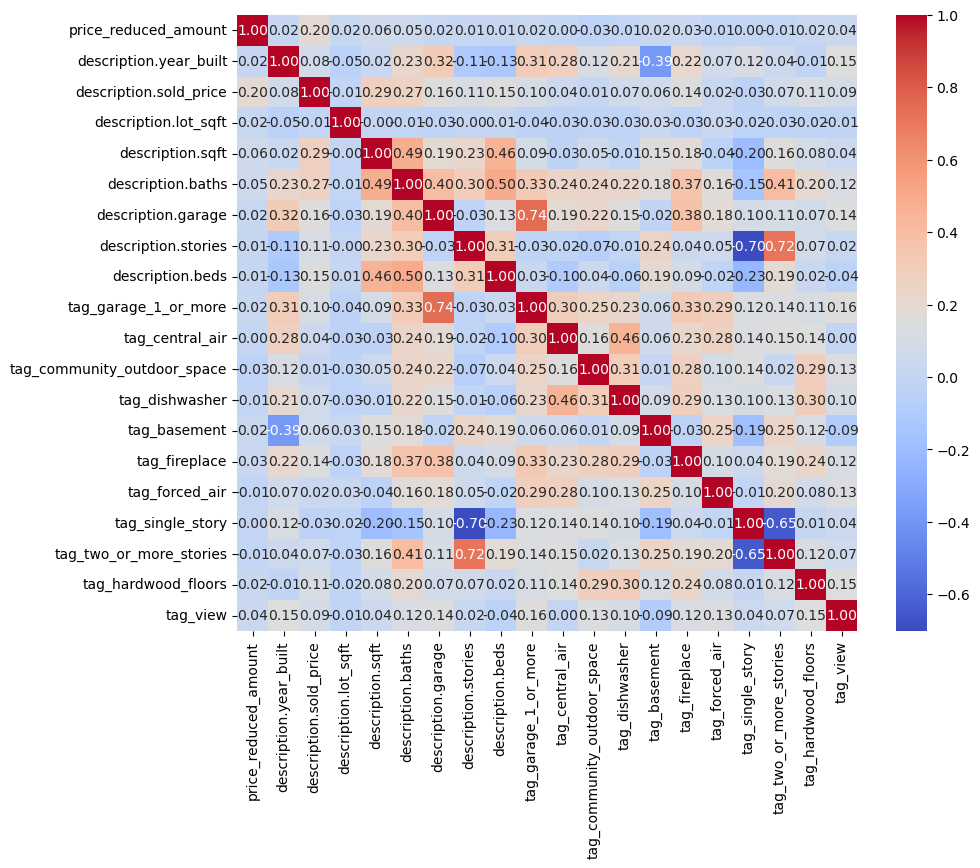

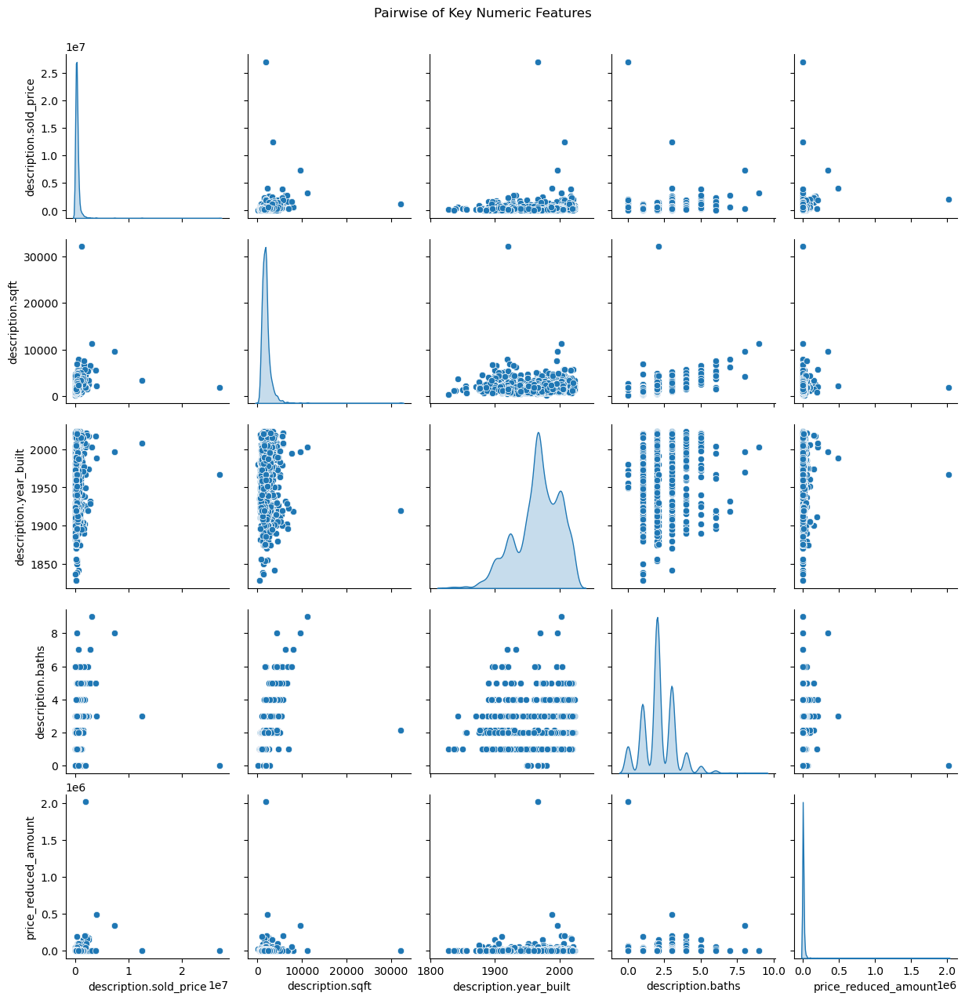

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1) Correlation heatmap
plt.figure(figsize=(10,8))
sns.heatmap(num_df.corr(), cmap="coolwarm", annot=True, fmt=".2f")
plt.show()

# 2) Pairplot of top 5 numeric features
top_feats = [
    "description.sold_price",
    "description.sqft",
    "description.year_built",
    "description.baths",
    "price_reduced_amount"
]

sns.pairplot(num_df[top_feats], diag_kind="kde")
plt.suptitle("Pairwise of Key Numeric Features", y=1.02)
plt.show()


## Scaling and Finishing Up

Now is a great time to scale the data and save it once it's preprocessed.
- You can save it in your data folder, but you may want to make a new `processed/` subfolder to keep it organized

In [42]:
# pull out X_train, X_test, y_train, y_test from train_df/test_df
X_train = train_df.drop("description.sold_price", axis=1)
X_test  = test_df .drop("description.sold_price", axis=1)

y_train = train_df["description.sold_price"]
y_test  = test_df ["description.sold_price"]

In [43]:
# pick only numeric columns
num_cols = X_train.select_dtypes(include=["number"]).columns

X_train_num = X_train[num_cols]
X_test_num  = X_test [num_cols]

# fit & transform
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler().fit(X_train_num)

X_train_scaled = pd.DataFrame(
    scaler.transform(X_train_num),
    columns=num_cols,
    index=X_train.index
)
X_test_scaled = pd.DataFrame(
    scaler.transform(X_test_num),
    columns=num_cols,
    index=X_test.index
)

# Save the processed data
os.makedirs("data/processed", exist_ok=True)
X_train_scaled.to_csv("data/processed/X_train_scaled.csv", index=False)
X_test_scaled .to_csv("data/processed/X_test_scaled.csv" , index=False)
y_train.to_frame().to_csv("data/processed/y_train.csv",      index=False)
y_test .to_frame().to_csv("data/processed/y_test.csv",       index=False)